# Physics-enhanced NeuralODEs in real-world applications
Tutorial by *Tobias Thummerer* based on the paper [*NeuralFMU: presenting a workflow for integrating hybrid NeuralODEs into real-world applications*](https://doi.org/10.3390/electronics11193202)

*(Work in progress, last edit: 09.01.2023)*

## Keywords
PeNODE, NeuralODE, Universal Differential Equation, Hybrid Modeling, Functional Mock-up Unit, FMU, NeuralFMU

## License

In [1]:
# Copyright (c) 2021 Tobias Thummerer, Lars Mikelsons
# Licensed under the MIT license. 
# See LICENSE (https://github.com/thummeto/FMIFlux.jl/blob/main/LICENSE) file in the project root for details.

## Introduction
In this tutorial, a *vehicle longitudinal-dynamics model* (VLDM) as used in automotive industry, is extended to a NeuralFMU (PeNODE) to make better consumption predictions. You don't know what NeuralFMUs/PeNODEs are? No problem, this will be briefly explained during this tutorial, too.

This tutorial is a more easy, code-focussed version of the paper [[1]](#Source), if you find it useful for your work, please cite the linked paper. In this example, a real-world simulation model is enhanced in terms of accuracy using a so called *physics-enhanced neural ordinary differential equation* (PeNode). Basically, this is an extension to the NeuralODE concept and looks as can be seen in Fig. 1.

![NeuralFMU.svg](https://github.com/thummeto/FMIFlux.jl/blob/main/docs/src/examples/img/mdpi_2022/neuralfmu.svg?raw=true)

*Fig.1: A possible representation for a physics-enhanced neural ordinary differential equation (PeNODE). An ODE model computes the system state derivative $\dot{\vec{x}}$ based on a given system state $\vec{x}$, inputs $\vec{u}$ and time $t$. The state derivative $\dot{\vec{x}}$ is manipulated by the ANN into $\hat{\dot{\vec{x}}}$ and finally integrated into the next system state $\vec{x}(t+h)$. PeNODEs that include FMUs instead of symbolic ODEs are called NeuralFMUs.*

Note, that this is only one possible topology of a PeNODE, there could be an additional artifical neural network (ANN) before the ODE (that might share some connections with the other ANN). Further also other signals, like FMU state derivatives, inputs and outputs could be connected to the ANN(s). ODEs are in general not very handy, for modeling **real** applications, a more suitable container for ODEs is needed. The most common model exchange format in industry is the *Functional Mock-up interface* (FMI), models exported with FMI are called *Functional Mock-up unit* (FMU). Especially *model-exchange* FMUs can be seen as containers for ODEs. For more information, see ([fmi-standard.org](http://fmi-standard.org/)). So if you want to use a real model from your modeling tool (with FMI support), you can simply export a FMU instead of handling large and bulky ODEs. If PeNODEs use FMUs instead of ODEs, they are called NeuralFMUs [[2]](#Source).

If that was a little bit fast, don't worry: This will be explained in detail later on.

### Formats
Besides, this [Jupyter Notebook](https://github.com/ThummeTo/FMIFlux.jl/blob/examples/examples/mdpi_2022.ipynb) there is also a [Julia file](https://github.com/thummeto/FMIFlux.jl/blob/examples/examples/mdpi_2022.jl) with the same name, which contains only the code cells. For the documentation there is a [Markdown file](https://github.com/thummeto/FMIFlux.jl/blob/examples/examples/mdpi_2022.md) corresponding to the notebook.  

### Installation prerequisites
|     | Description                       | Command                   | 
|:----|:----------------------------------|:--------------------------|
| 1.  | Enter Package Manager via         | ]                         |          
| 2.  | Install FMI via                   | add FMI                   | 
| 3.  | Install FMIFlux via               | add FMIFlux               |
| 4.  | Install FMIZoo via                | add FMIZoo                |
| 5.  | Install Plots via                 | add Plots                 |
| 6.  | Install Random via                | add Random                | 
| 7.  | Install JLD2 via                  | add JLD2                  | 

## Part 1: Loading the FMU

To run the example, the previously installed packages must be included. 

In [2]:
# Loading in the required libraries
using FMIFlux   # for NeuralFMUs
using FMI       # import FMUs into Julia 
using FMIZoo    # a collection of demo models, including the VLDM

import FMI.DifferentialEquations: Tsit5     # import the Tsit5-solver
using JLD2                                  # data format for saving/loading parameters

# plotting
import Plots        # default plotting framework

# for interactive plotting
# import PlotlyJS     # plotting (interactive)
# Plots.plotlyjs()    # actiavte PlotlyJS as default plotting backend

# Let's fix the random seed to make our program determinsitic (ANN layers are initialized indeterminsitic otherwise)
import Random 
Random.seed!(1234)

# we use the Tsit5 solver for ODEs here 
solver = Tsit5();   

Next, we load the FMU from the *FMIZoo.jl* and have a brief look on its metadata. For a more detailed view, see the [Modelica model](https://github.com/ThummeTo/FMIZoo.jl/blob/main/models/src/VLDM.mo).

In [3]:
# load our FMU (we take one from the FMIZoo.jl, exported with Dymola 2022x)
fmu = fmiLoad("VLDM", "Dymola", "2022x"; type=:ME, logLevel=FMI.FMIImport.FMULogLevelInfo)  # `FMULogLevelInfo` = "Log everything that might be interesting!", default is `FMULogLevelWarn`

# let's have a look on the model meta data
fmiInfo(fmu)

#################### Begin information for FMU ####################
	Model name:			Longitudinaldynamic.LongitudinaldynamicmodelContinuous
	FMI-Version:			2.0
	GUID:				{669889ab-7ab7-4fac-be92-96b6cd0b86a6}
	Generation tool:		Dymola Version 2020x (64-bit), 2019-10-10
	Generation time:		2022-07-22T09:32:50Z
	Var. naming conv.:		structured
	Event indicators:		28
	Inputs:				0
	Outputs:			0
	States:				6
		33554432 ["driver.accelerationPedalController.PI.x"]
		33554433 ["driver.brakePedalController.PI.x"]
		33554434 ["drivingCycle.s"]
		33554435 ["dynamics.accelerationCalculation.integrator.y"]
		33554436 ["dynamics.accelerationCalculation.limiter.u", "dynamics.accelerationCalculation.limIntegrator.y", "dynamics.accelerationCalculation.limiter.simplifiedExpr"]
		33554437 ["result.integrator.y"]
	Supports Co-Simulation:		true
		Model identifier:	Longitudinaldynamic_LongitudinaldynamicmodelContinuous
		Get/Set State:		true
		Serialize State:	true
		Dir. Derivatives:	true
		Var. com. steps:	

[ Info: fmi2Load(...): FMU resources location is `file:///C:/Users/RUNNER~1/AppData/Local/Temp/fmijl_7CItKz/VLDM/resources`


As you can see, in section *States* there are six states listed:

| ID  | Value Reference | Value Name(s)                                                                                    | Description                                          | 
|:----|:----------------|--------------------------------------------------------------------------------------------------|:-----------------------------------------------------|
| 1   | 33554432        | "driver.accelerationPedalController.PI.x"                                                        | PI-Controller state (integrated error), accelerating |       
| 2   | 33554433        | "driver.brakePedalController.PI.x"                                                               | PI-Controller state (integrated error), braking      | 
| 3   | 33554434        | "drivingCycle.s"                                                                                 | vehicle position (target)                            |
| 4   | 33554435        | "dynamics.accelerationCalculation.integrator.y"                                                  | vehicle position (actual)                             |
| 5   | 33554436        | "dynamics.accelerationCalculation.limiter.u", "dynamics.accelerationCalculation.limIntegrator.y" | vehicle velocity (actual)                            |
| 6   | 33554437        | "result.integrator.y"                                                                            | cumulative consumption * 3600                        |

Next thing is having a look on the real measurement data, that comes with the FMU. The VLDM and corresponding data are based on the [Component Library for Full Vehicle Simulations](https://github.com/TUMFTM/Component_Library_for_Full_Vehicle_Simulations) [[3]](#Source).

In [4]:
# load data from FMIZoo.jl, gather simulation parameters for FMU
data = FMIZoo.VLDM(split=:train)
tStart = data.consumption_t[1]
tStop = data.consumption_t[end]
tSave = data.consumption_t

# have a look on the FMU parameters (these are the file paths to the characteristic maps)
data.params

Dict{String, Any} with 3 entries:
  "peFileName" => "C:\\Users\\runneradmin\\.julia\\packages\\FMIZoo\\Yw7SL\\src…
  "edFileName" => "C:\\Users\\runneradmin\\.julia\\packages\\FMIZoo\\Yw7SL\\src…
  "dcFileName" => "C:\\Users\\runneradmin\\.julia\\packages\\FMIZoo\\Yw7SL\\src…

Finally, we do a single simulation run and compare the simulation output to the real data.

In [5]:
# let's run a simulation from `tStart` to `tStop`, use the parameters we just viewed for the simulation run
resultFMU = fmiSimulate(fmu, (tStart, tStop); parameters=data.params) 
fig = fmiPlot(resultFMU)                                                                        # Plot it, but this is a bit too much, so ...
fig = fmiPlot(resultFMU; stateIndices=6:6)                                                      # ... only plot the state #6 and ...
fig = fmiPlot(resultFMU; stateIndices=6:6, ylabel="Cumulative consumption [Ws]", label="FMU")   # ... add some helpful labels!

# further plot the (measurement) data values `consumption_val` and deviation between measurements `consumption_dev`
Plots.plot!(fig, data.consumption_t, data.consumption_val; label="Data", ribbon=data.consumption_dev, fillalpha=0.3)

Simulating ME-FMU ... 100%|██████████████████████████████| Time: 0:00:42
[ Info: fmiPlot(...): Number of state events (105) exceeding 100, disabling automatic plotting of state events (can be forced with keyword `stateEvents=true`).
[ Info: fmiPlot(...): Number of time events (110142) exceeding 100, disabling automatic plotting of time events (can be forced with keyword `timeEvents=true`).
[ Info: fmiPlot(...): Number of state events (105) exceeding 100, disabling automatic plotting of state events (can be forced with keyword `stateEvents=true`).
[ Info: fmiPlot(...): Number of time events (110142) exceeding 100, disabling automatic plotting of time events (can be forced with keyword `timeEvents=true`).
[ Info: fmiPlot(...): Number of state events (105) exceeding 100, disabling automatic plotting of state events (can be forced with keyword `stateEvents=true`).
[ Info: fmiPlot(...): Number of time events (110142) exceeding 100, disabling automatic plotting of time events (can be forced 

## Part 2: Designing the Topology

After we have successful loaded the FMU, had a look inside its model description and simulated it, we want to build a hybrid model (NeuralFMU) with our FMU as its core. 

### Part 2a: Interfaces between ANNs and FMUs
What happens between ANNs and FMUs?

Note, that FMUs and ANNs don't operate within the same numerical ranges. Whereas FMU signals can basically use the entire range of a Float64, ANNs operate the best in a range that suits theire activation functions. Many activation functions saturate their input values. Consider the $tanh$-activation, that acts almost linear close around $0$, but drastically saturates values further away from zero:

In [6]:
for i in [0.0, 0.01, 0.1, 1.0, 10.0, 100.0, 1000.0]
    println("tanh($(i)) = $(tanh(i))")
end

tanh(0.0) = 0.0
tanh(0.01) = 0.00999966667999946
tanh(0.1) = 0.09966799462495582
tanh(1.0) = 0.7615941559557649
tanh(10.0) = 0.9999999958776927
tanh(100.0) = 1.0
tanh(1000.0) = 1.0


Similarly for the opposite direction: Signals from ANNs into FMUs may be too small, because of the limited output of the ANNs (or better: their activation functions). To prevent this issue, an appropriate transformation (like shifting and scaling) between ANNs and FMUs is necessary. In the following code section, the results of ignoring this is shown, together with a fix by using the provided `ScaleShift`- and `ShiftScale`-layers from *FMIFlux.jl*.

In [7]:
# variable we want to manipulate - why we are picking exactly these three is shown a few lines later ;-)
manipulatedDerVars = ["der(dynamics.accelerationCalculation.integrator.y)",
                      "der(dynamics.accelerationCalculation.limIntegrator.y)",
                      "der(result.integrator.y)"]
# alternative: manipulatedDerVars = fmu.modelDescription.derivativeValueReferences[4:6]

# reference simulation to record the derivatives 
resultFMU = fmiSimulate(fmu, (tStart, tStop), parameters=data.params, recordValues=:derivatives, saveat=tSave) 
vals = fmiGetSolutionValue(resultFMU, manipulatedDerVars)

# what happens without propper transformation between FMU- and ANN-domain?
Plots.plot(resultFMU.values.t, vals[1,:][1]; label="vehicle velocity");
Plots.plot!(resultFMU.values.t, tanh.(vals[1,:][1]); label="tanh(velocity)")

# setup shift/scale layers for pre-processing
preProcess = ShiftScale(vals)

# check what it's doing now ...
testVals = collect(preProcess(collect(val[t] for val in vals))[1] for t in 1:length(resultFMU.values.t))
Plots.plot(resultFMU.values.t, testVals; label="velocity (pre-processed)");
Plots.plot!(resultFMU.values.t, tanh.(testVals); label="tanh(velocity)")

Simulating ME-FMU ... 100%|██████████████████████████████| Time: 0:00:30


In [8]:
# add some additional "buffer"
preProcess.scale[:] *= 0.5 

# and check again what it's doing now ...
testVals = collect(preProcess(collect(val[t] for val in vals))[1] for t in 1:length(resultFMU.values.t))
Plots.plot(resultFMU.values.t, testVals; label="velocity (pre-processed)");
Plots.plot!(resultFMU.values.t, tanh.(testVals); label="tanh(velocity)")

In [9]:
# ... also check the consumption
testVals = collect(preProcess(collect(val[t] for val in vals))[3] for t in 1:length(resultFMU.values.t))
Plots.plot(resultFMU.values.t, testVals; label="vehicle consumption (pre-processed)");
Plots.plot!(resultFMU.values.t, tanh.(testVals); label="tanh(consumption)")

In [10]:
# setup scale/shift layer (inverse transformation) for post-processing
# we don't an inverse transform for the entire preProcess, only for the 2nd element (acceleration)
postProcess = ScaleShift(preProcess; indices=2:2)

ScaleShift{Float64}([3.3007689403344145], [-0.002646582491370278])

As a little extra, these shifting and scaling parameters are optimized together with the ANN parameters in the later training process!

### Part 2b: ANN in- and output
Besides shifting and scaling, a major question is: What signals should be fed into the ANN and what signals should be output by it? We need to make some considerations:
- **What should be learned?** In theory, we could manipulate every interface signal from and to the FMU, but in real life this is not efficient. The more signals we connect, the more partial derivatives need to be determined during training. So if there is something you know about the model (and often there is more than just *something*) you can use that knowledge to make your hybrid model more efficient. So ask yourself: *What* should be learned? And right after that: *How* could it be learned? In mechanical applications the answer will often be: A force (or momentum in rotational systems). Forces result in a change of acceleration, so they can be expressed by an additional acceleration. In mechanical systems, the acceleration is almost always a state derivative (the derivative of the velocity), so in many cases, manipulating the most differentiated state derivative - the acceleration - is a very good choice. 
- **How many ANNs do we need?** Technically, you can add an arbitrary number of ANNs around your FMU (you can also use multiple FMUs if you want). But again, one should not use more than a single ANN if there is no good reason to do so. A second ANN *before* the FMU can be useful for example, if measurment offsets or similar effects should be corrected. Often, a single ANN to modify the state dynamics is sufficient.
- **What signals from the FMU should be inserted into the ANN?** In theory, we could use them all, meaning all states, state derivatives, time, inputs, outputs and other variables that are accessible through FMI. You know what comes next: Using less signals is the better choice, of course. If you know that the physical effect (here: the friction force), you have also an idea of what *influences* this effect or at least you know what values will have no impact and can be neglected to enhance training performance.

At this specific example, the following considerations were made:

| | Consideration                                                                                                                         | Considered inputs for the ANN |
|:---|--------------------------------------------------------------------------------------------------------------------------------------|--------|
| 1. | we have no system inputs, so $\vec{u}=\{\}$, nothing to add                                                                                                       | $\{\}$ |  
| 2. | we have no system outputs, so $\vec{y}=\{\}$, nothing to add                                                                                                      | $\{\}$ | 
| 3. | we know that the effect is not explicitly time-dependent on $t$, nothing to add                                                                       | $\{\}$ | 
| 4. | we have six states, that may influence the effect, add them                                                                                     | $\{x_1, x_2, x_3, x_4, x_5, x_6\}$ |  
| 5. | we have six state derivatives, that may influence the effect, add them                                                                         | $\{x_1, x_2, x_3, x_4, x_5, x_6\, \dot{x}_1, \dot{x}_2, \dot{x}_3, \dot{x}_4, \dot{x}_5, \dot{x}_6\}$ |  
| 6. | the system is modelled as second order ODE, the state $x_5$ (velocity) equlas the state derivative $\dot{x}_4$, remove $x_5$ | $\{x_1, x_2, x_3, x_4, x_6\, \dot{x}_1, \dot{x}_2, \dot{x}_3, \dot{x}_4, \dot{x}_5, \dot{x}_6\}$ | 
| 7. | we know that the friction effect is not dependent on the driver controller, remove two states ($x_1$ and $x_2$) and state derivatives ($\dot{x}_1$ and $\dot{x}_2$) | $\{x_3, x_4, x_6\, \dot{x}_3, \dot{x}_4, \dot{x}_5, \dot{x}_6\}$ | 
| 8. | we know that the friction effect is not dependent on the target driving cycle position $x_3$ or velocity $\dot{x}_3$, remove them | $\{x_4, x_6\, \dot{x}_4, \dot{x}_5, \dot{x}_6\}$ | 
| 9. | we assume that the friction effect is not dependent on the vehicle position $x_4$, remove $x_4$ | $\{x_6\, \dot{x}_4, \dot{x}_5, \dot{x}_6\}$ | 
| 10. | we assume that the friction effect is not dependent on the accumulated vehicle consumption $x_6$, remove $x_6$ | $\{\dot{x}_4, \dot{x}_5, \dot{x}_6\}$ | 

These considerations lead to the following topology:

![usedneuralfmu.svg](https://github.com/thummeto/FMIFlux.jl/blob/main/docs/src/examples/img/mdpi_2022/usedneuralfmu.svg?raw=true)

*Fig.2: The used topology for a NeuralFMU in this example. The ANN operates based on the signals $\dot{x}_4, \dot{x}_5, \dot{x}_6$ from the FMU, but only modifies the signal $\hat{\dot{x}}_5$. The gates $p_{FMU}$ and $p_{ANN}$ control how much the dynamics of FMU and ANN contribute to the NeuralFMU dynamics. Starting with $p_{FMU}=1.0$ and $p_{ANN}=0.0$ makes an initialization routine obsolete, because the dynamics of the NeuralFMU equal the dynamics of the FMU, see [[1]](#Source) for further details.*

### Part 2c: Translating topology to Julia
To implement the signal bypass in a layer sequence, two layers named `CacheLayer` and `CacheRetrieveLayer` are used to cache and retrieve arbitrary values:

In [11]:
# setup cache layers 
cache = CacheLayer()
cacheRetrieve = CacheRetrieveLayer(cache)

gates = ScaleSum([1.0, 0.0]) # signal from FMU (#1 = 1.0), signal from ANN (#2 = 0.0)

# evaluate the FMU by calling it, we are only interessted in `dx` in this case
function evalFMU(x)
    y, dx = fmu(; x=x)
    return dx 
end

# setup the NeuralFMU topology
net = Chain(x -> evalFMU(x),                    # take `x`, put it into the FMU, retrieve `dx`
            dx -> cache(dx),                    # cache `dx`
            dx -> dx[4:6],                      # forward only dx[4, 5, 6]
            preProcess,                         # pre-process `dx`
            Dense(3, 32, tanh),                 # Dense Layer 3 -> 32 with `tanh` activasion
            Dense(32, 1, tanh),                 # Dense Layer 32 -> 1 with `tanh` activasion 
            postProcess,                        # post process `dx`
            dx -> cacheRetrieve(5:5, dx),       # dynamics FMU | dynamics ANN
            gates,                              # compute resulting dx from ANN + FMU
            dx -> cacheRetrieve(1:4, dx, 6:6))  # stack together: dx[1,2,3,4] from cache + dx from ANN + dx[6] from cache

# build NeuralFMU
neuralFMU = ME_NeuralFMU(fmu, net, (tStart, tStop), solver; saveat=tSave)
neuralFMU.modifiedState = false # speed optimization (no ANN before the FMU)

# get start state vector from data (FMIZoo)
x0 = FMIZoo.getStateVector(data, tStart)

# simulate and plot the (uninitialized) NeuralFMU
resultNFMU_original = neuralFMU(x0, (tStart, tStop); parameters=data.params, showProgress=true) 
fig = fmiPlot(resultNFMU_original; stateIndices=5:5, label="NeuralFMU (original)", ylabel="velocity [m/s]")

# plot the original FMU and data
fmiPlot!(fig, resultFMU; stateIndices=5:5, values=false)
Plots.plot!(fig, data.speed_t, data.speed_val, label="Data")

Simulating ME-NeuralFMU ...  99%|████████████████████████|  ETA: 0:00:01[ Info: fmiPlot(...): Number of state events (105) exceeding 100, disabling automatic plotting of state events (can be forced with keyword `stateEvents=true`).
[ Info: fmiPlot(...): Number of time events (110142) exceeding 100, disabling automatic plotting of time events (can be forced with keyword `timeEvents=true`).
[ Info: fmiPlot(...): Number of state events (105) exceeding 100, disabling automatic plotting of state events (can be forced with keyword `stateEvents=true`).
[ Info: fmiPlot(...): Number of time events (110142) exceeding 100, disabling automatic plotting of time events (can be forced with keyword `timeEvents=true`).


As to expect, all trajectories overlap.

### Part 2d: Initialization
In general, initialization of (phyiscs-enhanced) NeuralODEs is challenging, because ANNs are initialized random by default. In this case we are using a special initialization method introducing two gates, that control how much of the original FMU dynamics and how much of the ANN dynamics is introduced to the final model dynamics. See the paper [[1]](#Source) for a deeper insight.

## Part 3: Training

Finally: The actual training!

Basically, you can use your custom loss function, batching strategies and optimsation routines with *FMIFlux.jl*. Because we need to keep it short here, we use some tools already shipped with *FMIFlux.jl*.

┌ Warning: Batch element does not provide a `initialState`, I try to simulate anyway. InitialState is overwritten.
└ @ FMIFlux D:\a\FMIFlux.jl\FMIFlux.jl\src\batch.jl:111


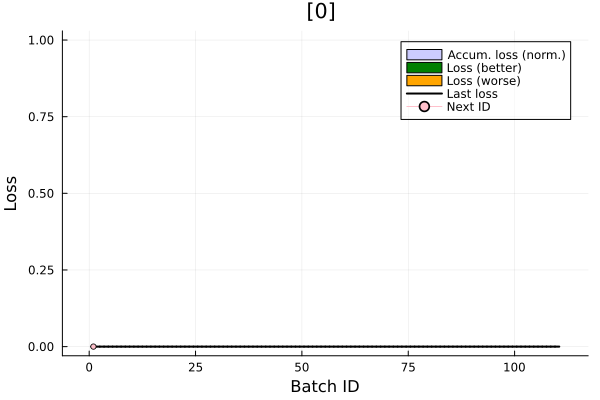

1.853901634445119e9

In [12]:
# prepare training data (array of arrays required)
train_data = collect([d] for d in data.consumption_val)
train_t = data.consumption_t 

# switch to a more efficient execution configuration, allocate only a singel FMU instance, see:
# https://thummeto.github.io/FMI.jl/dev/features/#Execution-Configuration
fmu.executionConfig = FMI.FMIImport.FMU2_EXECUTION_CONFIGURATION_NOTHING
c, _ = FMIFlux.prepareSolveFMU(neuralFMU.fmu, nothing, neuralFMU.fmu.type, true, false, false, false, true, data.params; x0=x0)

# batch the data (time, targets), train only on model output index 6, plot batch elements
batch = batchDataSolution(neuralFMU, t -> FMIZoo.getStateVector(data, t), train_t, train_data;
    batchDuration=10.0, indicesModel=6:6, plot=false, parameters=data.params, showProgress=false) # try `plot=true` to show the batch elements, try `showProgress=true` to display simulation progress

# limit the maximum number of solver steps to 1e5 and maximum simulation/training duration to 30 minutes
solverKwargsTrain = Dict{Symbol, Any}(:maxiters => 1e5, :max_execution_duration => 10.0*60.0)

# picks a modified MSE, which weights the last time point MSE with 25% and the remaining element MSE with 75%
# this promotes training a continuous function, even when training on batch elements
lossFct = (a, b) -> FMIFlux.Losses.mse_last_element_rel(a, b, 0.5)
lossFct([1.0, 2.0], [0.0, 0.0]) # (1.0)^2 * 0.75 + (2.0)^2 * 0.25

# initialize a "worst error growth scheduler" (updates all batch losses, pick the batch element with largest error increase)
# apply the scheduler after every training step, plot the current status every 25 steps and update all batch element losses every 5 steps
scheduler = LossAccumulationScheduler(neuralFMU, batch, lossFct; applyStep=1, plotStep=25, updateStep=5)
updateScheduler = () -> update!(scheduler)

# defines a loss for the entire batch (accumulate error of batch elements)
batch_loss = p -> FMIFlux.Losses.batch_loss(neuralFMU, batch; 
    showProgress=false, p=p, parameters=data.params, update=true, lossFct=lossFct, logLoss=true, solverKwargsTrain...) # try `showProgress=true` to display simulation progress

# loss for training, take element from the worst element scheduler
loss = p -> FMIFlux.Losses.loss(neuralFMU, batch; 
    showProgress=false, p=p, parameters=data.params, lossFct=lossFct, batchIndex=scheduler.elementIndex, logLoss=false, solverKwargsTrain...) # try `showProgress=true` to display simulation progress

# we start with a slightly opended ANN gate (1%) and a almost completely opened FMU gate (99%)
gates.scale[:] = [0.99, 0.01] 

# gather the parameters from the NeuralFMU
params = FMIFlux.params(neuralFMU)

params[1][end-1] = 0.99
params[1][end] = 0.01

# for training, we use the Adam optimizer with step size 1e-3
optim = Adam(1e-3) 

# initialize the scheduler 
initialize!(scheduler; parameters=data.params, p=params[1], showProgress=false)

# let's check the loss we are starting with ...
batch_loss(params[1])

Finally, the lines we are waiting for so long:

[ Info: AVG: 1.69e+07 | MAX: 9.87e+07 @ #1
[ Info: AVG: 1.69e+07 | MAX: 9.87e+07 @ #94
[ Info: AVG: 1.69e+07 | MAX: 9.87e+07 @ #89
[ Info: AVG: 1.69e+07 | MAX: 9.87e+07 @ #94
[ Info: AVG: 1.18e+07 | MAX: 8.74e+07 @ #98
[ Info: AVG: 1.18e+07 | MAX: 8.74e+07 @ #70
[ Info: AVG: 1.18e+07 | MAX: 8.74e+07 @ #49
[ Info: AVG: 1.18e+07 | MAX: 8.74e+07 @ #82
[ Info: AVG: 1.18e+07 | MAX: 8.74e+07 @ #94
[ Info: AVG: 2.69e+07 | MAX: 2.96e+08 @ #69
[ Info: AVG: 2.69e+07 | MAX: 2.96e+08 @ #88
[ Info: AVG: 2.69e+07 | MAX: 2.96e+08 @ #87
[ Info: AVG: 2.69e+07 | MAX: 2.96e+08 @ #103
[ Info: AVG: 2.69e+07 | MAX: 2.96e+08 @ #88
[ Info: AVG: 1.11e+07 | MAX: 8.15e+07 @ #93
[ Info: AVG: 1.11e+07 | MAX: 8.15e+07 @ #98
[ Info: AVG: 1.11e+07 | MAX: 8.15e+07 @ #89
[ Info: AVG: 1.11e+07 | MAX: 8.15e+07 @ #57
[ Info: AVG: 1.11e+07 | MAX: 8.15e+07 @ #94
[ Info: AVG: 1.11e+07 | MAX: 8.64e+07 @ #70
[ Info: AVG: 1.11e+07 | MAX: 8.64e+07 @ #49
[ Info: AVG: 1.11e+07 | MAX: 8.64e+07 @ #95
[ Info: AVG: 1.11e+07 | MAX: 8.6

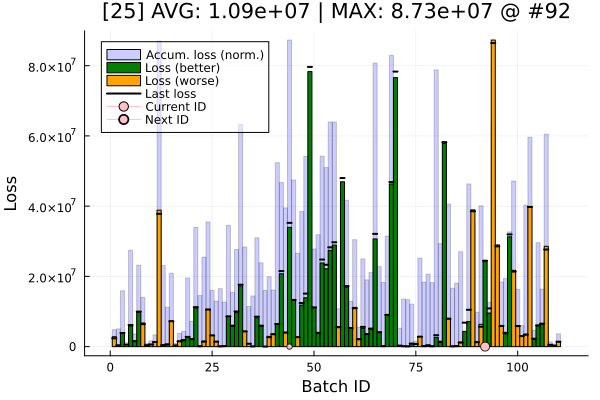

[ Info: AVG: 1.09e+07 | MAX: 8.73e+07 @ #44
[ Info: AVG: 1.09e+07 | MAX: 8.73e+07 @ #12
[ Info: AVG: 1.09e+07 | MAX: 8.73e+07 @ #69
[ Info: AVG: 1.09e+07 | MAX: 8.73e+07 @ #94
[ Info: AVG: 1.07e+07 | MAX: 8.64e+07 @ #65
[ Info: AVG: 1.07e+07 | MAX: 8.64e+07 @ #70
[ Info: AVG: 1.07e+07 | MAX: 8.64e+07 @ #49
[ Info: AVG: 1.07e+07 | MAX: 8.64e+07 @ #103
[ Info: AVG: 1.07e+07 | MAX: 8.64e+07 @ #55
[ Info: AVG: 1.07e+07 | MAX: 8.55e+07 @ #54
[ Info: AVG: 1.07e+07 | MAX: 8.55e+07 @ #107
[ Info: AVG: 1.07e+07 | MAX: 8.55e+07 @ #57
[ Info: AVG: 1.07e+07 | MAX: 8.55e+07 @ #32
[ Info: AVG: 1.07e+07 | MAX: 8.55e+07 @ #94
[ Info: AVG: 1.08e+07 | MAX: 8.42e+07 @ #82
[ Info: AVG: 1.08e+07 | MAX: 8.42e+07 @ #89
[ Info: AVG: 1.08e+07 | MAX: 8.42e+07 @ #52
[ Info: AVG: 1.08e+07 | MAX: 8.42e+07 @ #98
[ Info: AVG: 1.08e+07 | MAX: 8.42e+07 @ #70
[ Info: AVG: 1.06e+07 | MAX: 8.18e+07 @ #49
[ Info: AVG: 1.06e+07 | MAX: 8.18e+07 @ #53
[ Info: AVG: 1.06e+07 | MAX: 8.18e+07 @ #99
[ Info: AVG: 1.06e+07 | MAX: 8

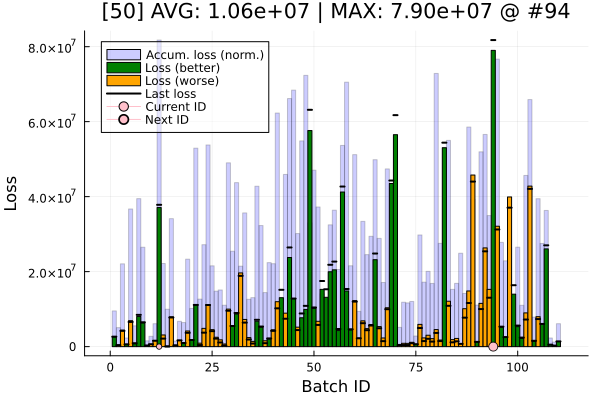

[ Info: AVG: 1.06e+07 | MAX: 7.90e+07 @ #12
[ Info: AVG: 1.06e+07 | MAX: 7.90e+07 @ #95
[ Info: AVG: 1.06e+07 | MAX: 7.90e+07 @ #48
[ Info: AVG: 1.06e+07 | MAX: 7.90e+07 @ #103
[ Info: AVG: 1.04e+07 | MAX: 7.54e+07 @ #58
[ Info: AVG: 1.04e+07 | MAX: 7.54e+07 @ #44
[ Info: AVG: 1.04e+07 | MAX: 7.54e+07 @ #82
[ Info: AVG: 1.04e+07 | MAX: 7.54e+07 @ #57
[ Info: AVG: 1.04e+07 | MAX: 7.54e+07 @ #45
[ Info: AVG: 1.03e+07 | MAX: 7.22e+07 @ #70
[ Info: AVG: 1.03e+07 | MAX: 7.22e+07 @ #49
[ Info: AVG: 1.03e+07 | MAX: 7.22e+07 @ #89
[ Info: AVG: 1.03e+07 | MAX: 7.22e+07 @ #94
[ Info: AVG: 1.03e+07 | MAX: 7.22e+07 @ #92
[ Info: AVG: 1.02e+07 | MAX: 6.81e+07 @ #80
[ Info: AVG: 1.02e+07 | MAX: 6.81e+07 @ #98
[ Info: AVG: 1.02e+07 | MAX: 6.81e+07 @ #88
[ Info: AVG: 1.02e+07 | MAX: 6.81e+07 @ #65
[ Info: AVG: 1.02e+07 | MAX: 6.81e+07 @ #41
[ Info: AVG: 8.41e+06 | MAX: 6.29e+07 @ #69
[ Info: AVG: 8.41e+06 | MAX: 6.29e+07 @ #107
[ Info: AVG: 8.41e+06 | MAX: 6.29e+07 @ #83
[ Info: AVG: 8.41e+06 | MAX: 6

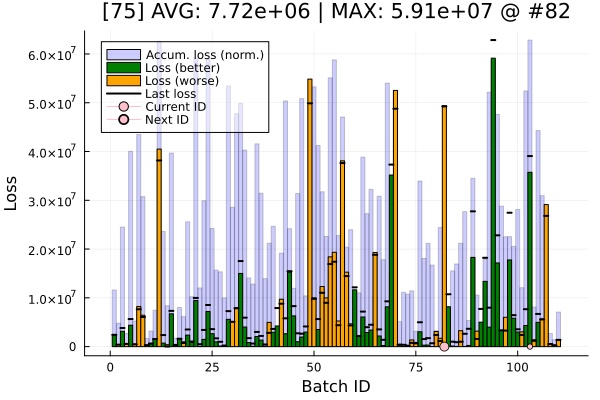

[ Info: AVG: 7.72e+06 | MAX: 5.91e+07 @ #103
[ Info: AVG: 7.72e+06 | MAX: 5.91e+07 @ #12
[ Info: AVG: 7.72e+06 | MAX: 5.91e+07 @ #94
[ Info: AVG: 7.72e+06 | MAX: 5.91e+07 @ #70
[ Info: AVG: 7.44e+06 | MAX: 5.57e+07 @ #49
[ Info: AVG: 7.44e+06 | MAX: 5.57e+07 @ #55
[ Info: AVG: 7.44e+06 | MAX: 5.57e+07 @ #21
[ Info: AVG: 7.44e+06 | MAX: 5.57e+07 @ #57
[ Info: AVG: 7.44e+06 | MAX: 5.57e+07 @ #54
[ Info: AVG: 7.00e+06 | MAX: 5.08e+07 @ #24
[ Info: AVG: 7.00e+06 | MAX: 5.08e+07 @ #50
[ Info: AVG: 7.00e+06 | MAX: 5.08e+07 @ #32
[ Info: AVG: 7.00e+06 | MAX: 5.08e+07 @ #68
[ Info: AVG: 7.00e+06 | MAX: 5.08e+07 @ #95
[ Info: AVG: 6.74e+06 | MAX: 4.75e+07 @ #29
[ Info: AVG: 6.74e+06 | MAX: 4.75e+07 @ #102
[ Info: AVG: 6.74e+06 | MAX: 4.75e+07 @ #93
[ Info: AVG: 6.74e+06 | MAX: 4.75e+07 @ #82
[ Info: AVG: 6.74e+06 | MAX: 4.75e+07 @ #94
[ Info: AVG: 6.43e+06 | MAX: 4.40e+07 @ #69
[ Info: AVG: 6.43e+06 | MAX: 4.40e+07 @ #31
[ Info: AVG: 6.43e+06 | MAX: 4.40e+07 @ #70
[ Info: AVG: 6.43e+06 | MAX: 4

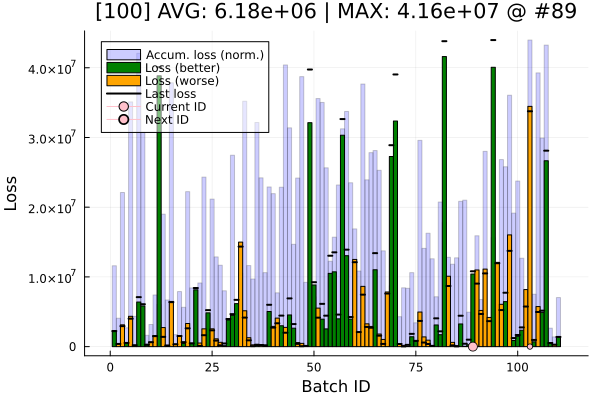

[ Info: AVG: 6.18e+06 | MAX: 4.16e+07 @ #103
[ Info: AVG: 6.18e+06 | MAX: 4.16e+07 @ #107
[ Info: AVG: 6.18e+06 | MAX: 4.16e+07 @ #7
[ Info: AVG: 6.18e+06 | MAX: 4.16e+07 @ #43
[ Info: AVG: 6.41e+06 | MAX: 3.95e+07 @ #105
[ Info: AVG: 6.41e+06 | MAX: 3.95e+07 @ #98
[ Info: AVG: 6.41e+06 | MAX: 3.95e+07 @ #62
[ Info: AVG: 6.41e+06 | MAX: 3.95e+07 @ #57
[ Info: AVG: 6.41e+06 | MAX: 3.95e+07 @ #15
[ Info: AVG: 6.18e+06 | MAX: 3.86e+07 @ #58


6.804302644283746e8

In [13]:
batchLen = length(batch)
FMIFlux.train!(loss, params, Iterators.repeated((), batchLen), optim; chunk_size=length(params[1]), cb=updateScheduler) 
batch_loss(params[1])

The batch loss ("AVG" and "MAX") is only updated every 5 steps, as defined in the scheduler. Every 25 steps, we plot the current batch element losses. Please note, that we only did around 100 training steps, so training has not converged for now. But we are curious and want to have a look on the intermediate results. 

After training, it seems a good idea to store the optimized parameters for later use:

In [14]:
# save the parameters (so we can use them tomorrow again)
paramsPath = joinpath(@__DIR__, "params_$(scheduler.step)steps.jld2")
fmiSaveParameters(neuralFMU, paramsPath)

# switch back to the default execution configuration, see:
# https://thummeto.github.io/FMI.jl/dev/features/#Execution-Configuration
fmu.executionConfig = FMI.FMIImport.FMU2_EXECUTION_CONFIGURATION_NO_RESET
FMIFlux.finishSolveFMU(neuralFMU.fmu, c, false, true)

The loss has decreased, but the final question is: Are we better? This can be easily checked by running a simulation and compare it to the training data:

In [15]:
# check what had been learned by the NeuralFMU, simulate it ...
resultNFMU_train = neuralFMU(x0, (tStart, tStop); parameters=data.params, showProgress=true, recordValues=manipulatedDerVars, maxiters=1e7) # [120s]

# Load parameters 
fmiLoadParameters(neuralFMU, paramsPath)

# are we better?
mse_NFMU = FMIFlux.Losses.mse(data.consumption_val, fmiGetSolutionState(resultNFMU_train, 6; isIndex=true))
mse_FMU  = FMIFlux.Losses.mse(data.consumption_val, fmiGetSolutionState(resultFMU, 6; isIndex=true))

# ... and plot it
fig = fmiPlot(resultNFMU_train; stateIndices=6:6, values=false, stateEvents=false, label="NeuralFMU", title="Training Data");
fmiPlot!(fig, resultFMU; stateIndices=6:6, stateEvents=false, values=false, label="FMU");
Plots.plot!(fig, train_t, data.consumption_val, label="Data", ribbon=data.consumption_dev, fillalpha=0.3)

Simulating ME-NeuralFMU ... 100%|████████████████████████|  ETA: 0:00:00[ Info: fmiPlot(...): Number of time events (110142) exceeding 100, disabling automatic plotting of time events (can be forced with keyword `timeEvents=true`).
[ Info: fmiPlot(...): Number of time events (110142) exceeding 100, disabling automatic plotting of time events (can be forced with keyword `timeEvents=true`).


## Part 4: Results discussion

**WIP: coming soon!**

In [16]:
# clean-up
fmiUnload(fmu) 

### Source

[1] Tobias Thummerer, Johannes Stoljar and Lars Mikelsons. 2022. **NeuralFMU: presenting a workflow for integrating hybrid NeuralODEs into real-world applications.** Electronics 11, 19, 3202. [DOI: 10.3390/electronics11193202](https://doi.org/10.3390/electronics11193202)


[2] Tobias Thummerer, Lars Mikelsons and Josef Kircher. 2021. **NeuralFMU: towards structural integration of FMUs into neural networks.** Martin Sjölund, Lena Buffoni, Adrian Pop and Lennart Ochel (Ed.). Proceedings of 14th Modelica Conference 2021, Linköping, Sweden, September 20-24, 2021. Linköping University Electronic Press, Linköping (Linköping Electronic Conference Proceedings ; 181), 297-306. [DOI: 10.3384/ecp21181297](https://doi.org/10.3384/ecp21181297)

[3] Danquah, B.; Koch, A.; Weis, T.; Lienkamp, M.; Pinnel, A. 2019. **Modular, Open Source Simulation Approach: Application to Design and Analyze Electric Vehicles.** In Proceedings of the IEEE 2019 Fourteenth International Conference on Ecological Vehicles and Renewable Energies (EVER), Monte Carlo, Monaco, 8–10 May 2019; pp. 1–8. [DOI: 10.1109/EVER.2019.8813568](https://doi.org/10.1109/EVER.2019.8813568).
